# scRNAseq Analysis of Puram et al 2017 Cell paper

## Load libraries and change directories

In [2]:
import os 
import numpy as np
import seaborn as sns
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.manifold import TSNE
import umap
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

os.chdir("C:/Users/araddatz3/Desktop/Code/redox_model/code")

## Load scRNAseq and clinical data

In [3]:
raw_df = pd.read_csv(os.getcwd() + "/data/labeled_raw_counts.csv", index_col=0)
raw_df = raw_df.T
raw_df.rename(columns=lambda x: x[1:-1], inplace=True)

patients = list()

for index in raw_df.index.values:
    patient = index.split("_")[0]
    if patient in ["HNSCC5", "HNSCC6", "HNSCC7", "HNSCC8"]: 
        patients.append(patient[-1])
    elif patient == "HNSCC": 
        patients.append("1")
    else:
        patients.append(patient[-2:])

raw_df["Patient"] = patients
raw_df.index = [i for i in range(1,len(raw_df)+1)]

clin_df = pd.read_csv(os.getcwd() + "/data/clinical_data_scrnaseq.csv", index_col=0)

full_df = clin_df.merge(raw_df,left_index=True,right_index=True)

top_patients_df = full_df[full_df["Patient"].isin(["5", "6", "16", "17", "18", "20", "22", "25", "26", "28"])]

clin_cols = ["Lymph node","classified  as cancer cell","classified as non-cancer cells","non-cancer index","Patient"]
genes_of_interest = ["NFE2L2","KEAP1","ABCC3","GSTP1","NQO1","SOD1","SOD2","SOD3",
                    "AQP3","AQP8","AQP9","GJA1","CAT","GSR","GLRX","GLRX2","GLRX3","G6PD","GLUD1","GCLC","GCLM",
                    "TXNRD1","TXNRD2","TXNRD3","GPX1","GPX2","GPX3","GPX4","PRDX1","PRDX2","PRDX3","PRDX4","PRDX5","PRDX6","TXN"
                    ]
redox_df = top_patients_df[clin_cols + genes_of_interest]

cell_names = list()
iscancer = list()
for ix, cell in enumerate(redox_df["non-cancer index"]):
    if cell == 0.0:
        cell_names.append("Cancer")
        iscancer.append("Malignant")
    elif cell == 1.0:
        cell_names.append("Fibroblast")
    elif cell == 2.0:
        cell_names.append("B Cell")
    elif cell == 3.0:
        cell_names.append("Myocyte")
    elif cell == 4.0:
        cell_names.append("Macrophage")
    elif cell == 5.0:
        cell_names.append("Endothelial")
    elif cell == 6.0:
        cell_names.append("T Cell")
    elif cell == 7.0:
        cell_names.append("Dendritic")
    elif cell == 8.0:
        cell_names.append("Mast")
    else:
        print(cell)

#redox_df["Stromal Cell Type"] = cell_names

cancer_redox_df = redox_df[redox_df["classified as non-cancer cells"] == 0]
healthy_redox_df = redox_df[redox_df["classified as non-cancer cells"] != 0]


In [4]:
redox_df["Patient"].unique()

array(['28', '26', '25', '22', '18', '20', '17', '16', '6', '5'],
      dtype=object)

In [5]:
redox_df[redox_df["classified  as cancer cell"] == 0].shape

(2816, 40)

In [6]:
redox_tsne = TSNE(n_components=2,n_jobs=-1,init='pca').fit_transform(redox_df)
healthy_tsne = TSNE(n_components=2,n_jobs=-1,init='pca').fit_transform(healthy_redox_df)
cancer_tsne = TSNE(n_components=2,n_jobs=-1,init='pca').fit_transform(cancer_redox_df)

C:\Users\araddatz3\Anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\araddatz3\Anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
C:\Users\araddatz3\Anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\araddatz3\Anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
C:\Users\araddatz3\Anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:805: FutureWarning: The default learning rate in TSN

In [43]:
3363+2215

5578

In [53]:
os.getcwd()

'C:\\Users\\araddatz3\\Desktop\\Code\\redox_model\\code'

In [7]:
sns.set(rc={'figure.figsize':(16,22), "figure.dpi": 600})
sns.set(font_scale=1.5)
sns.set_style("white")
fig = plt.figure()
ax1 = fig.add_subplot(311)
ax2 = fig.add_subplot(323)
ax3 = fig.add_subplot(324)
ax4 = fig.add_subplot(325)
ax5 = fig.add_subplot(326)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],hue=cancer_redox_df["Patient"],palette="muted",ax=ax1)#,c=cancer_redox_df["NQO1"],cmap="coolwarm",ax=ax)
ax1.set(xlabel="tSNE 1",
      ylabel="tSNE 2",
      title="Malignant Cells")
ax1.legend(fontsize="x-small", title="Patient #",ncol=2)

# NQO1
points = ax2.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["NQO1"], s=5, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax2)
cbar.ax.set_ylabel('NQO1 Expression (TPM)', rotation=270)
cbar.ax.yaxis.set_label_coords(3.2,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["NQO1"],s=5,cmap="coolwarm",ax=ax2)
#ax.get_legend().remove()
ax2.set(xlabel="tSNE 1",
      ylabel="tSNE 2")

# GLUD1
points = ax3.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["GLUD1"], s=5, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax3)
cbar.ax.set_ylabel('GLUD1 Expression (TPM)', rotation=270)
cbar.ax.yaxis.set_label_coords(3.2,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["GLUD1"],s=5,cmap="coolwarm",ax=ax3)
#ax.get_legend().remove()
ax3.set(xlabel="tSNE 1",
      ylabel="tSNE 2")

# TXN
points = ax4.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["TXN"], s=5, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax4)
cbar.ax.set_ylabel('TXN Expression (TPM)', rotation=270)
cbar.ax.yaxis.set_label_coords(3.2,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["TXN"],s=5,cmap="coolwarm",ax=ax4)
#ax.get_legend().remove()
ax4.set(xlabel="tSNE 1",
      ylabel="tSNE 2")

# TXNRD1
points = ax5.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["TXNRD1"], s=5, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax5)
cbar.ax.set_ylabel('TXNRD1 Expression (TPM)', rotation=270)
cbar.ax.yaxis.set_label_coords(3.2,0.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["TXNRD1"],s=5,cmap="coolwarm",ax=ax5)
#ax.get_legend().remove()
ax5.set(xlabel="tSNE 1",
      ylabel="tSNE 2")
#plt.savefig(os.getcwd()+"/../figures/fig3b.png")
#plt.show()
plt.savefig(os.getcwd()+"/../figures/fig3.png")
#plt.show()

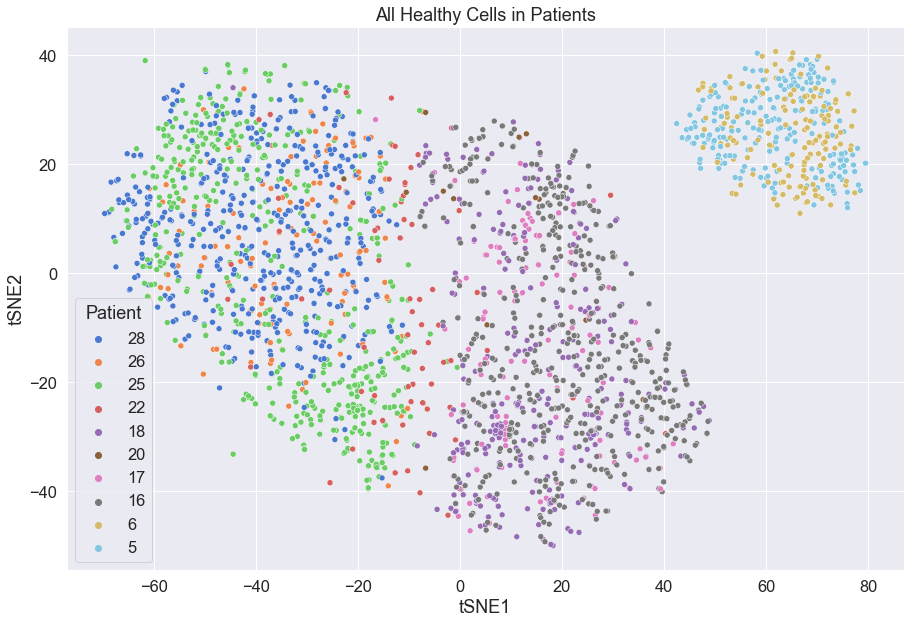

In [19]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
sns.set_style("white")
fig, ax = plt.subplots()
sns.scatterplot(x=healthy_tsne[:,0],y=healthy_tsne[:,1],hue=healthy_redox_df["Patient"],palette="muted",ax=ax)
ax.set(xlabel="tSNE1",
      ylabel="tSNE2",
      title="All Healthy Cells in Patients")


#plt.savefig(os.getcwd()+"/20210823/healthy_redoxgenes_PCAinit_tumorcolor.png")
#plt.show()

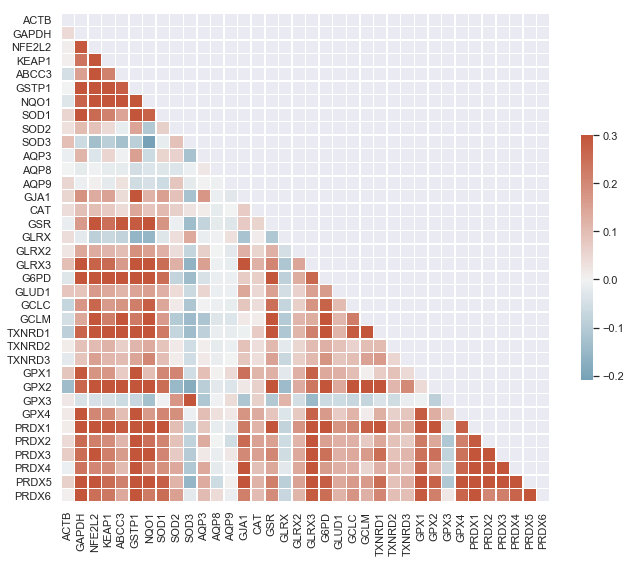

In [35]:
gene_df = redox_df.iloc[:,5:-1]
corr = gene_df.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.savefig("correlation_heatmap.png")

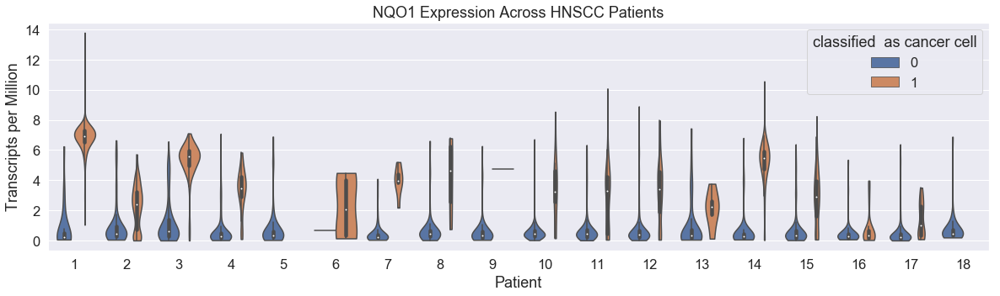

In [5]:
sns.set(rc={'figure.figsize':(20,5)})
sns.set(font_scale=1.5)
imp_genes = ["NQO1"]
for gene_name in imp_genes:
    ax = sns.violinplot(x="tumor",y=gene_name,hue="classified  as cancer cell",data=full_df[full_df["Lymph node"] == 0],cut=0,bw="scott")
    ax.set(xlabel="Patient", ylabel="Transcripts per Million", title=gene_name+" Expression Across HNSCC Patients")
    #plt.savefig(os.getcwd() + "/figures/scRNAseq_violinplots/genes_per_patient/" + gene_name + ".png")
    plt.show()

In [26]:
temp_df

,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer index,Patient,NFE2L2,KEAP1,ABCC3,GSTP1,NQO1,...,GPX2,GPX3,GPX4,PRDX1,PRDX2,PRDX3,PRDX4,PRDX5,PRDX6,TXN
cell,,,,,,,,,,,,,,,,,,,,,


In [28]:
# index 0: non-malignant cell count
# index 1: cancer cell count
# index 2: cancer cell count in tumor
# index 3: cancer cell count in lymph node
cellcount_data = np.zeros((18,6))
for patient, patient_id in enumerate(["5", "6", "16", "17", "18", "20", "22", "25", "26", "28"]):
    temp_df = redox_df[(redox_df["Patient"] == patient_id)]
    cellcount_data[patient,0] = temp_df[temp_df["classified  as cancer cell"] == 0].shape[0]
    cellcount_data[patient,1] = temp_df[temp_df["classified  as cancer cell"] == 1].shape[0]
    cellcount_data[patient,2] = temp_df[(temp_df["Lymph node"] == 0) & (temp_df["classified  as cancer cell"] == 0)].shape[0]
    cellcount_data[patient,3] = temp_df[(temp_df["Lymph node"] == 0) & (temp_df["classified  as cancer cell"] == 1)].shape[0]
    cellcount_data[patient,4] = temp_df[(temp_df["Lymph node"] == 1) & (temp_df["classified  as cancer cell"] == 0)].shape[0]
    cellcount_data[patient,5] = temp_df[(temp_df["Lymph node"] == 1) & (temp_df["classified  as cancer cell"] == 1)].shape[0]
    print("Patient " + str(patient_id) + " has " + str(cellcount_data[patient,0]) + " non-malignant cells sequenced")   
    print("Patient " + str(patient_id) + " has " + str(cellcount_data[patient,1]) + " cancer cells sequenced")
    print("Patient " + str(patient_id) + " has " + str(cellcount_data[patient,2]) + " healthy cells in the tumor sequenced")
    print("Patient " + str(patient_id) + " has " + str(cellcount_data[patient,3]) + " cancer cells in the tumor sequenced")
    print("Patient " + str(patient_id) + " has " + str(cellcount_data[patient,4]) + " healthy cells in the LN sequenced")
    print("Patient " + str(patient_id) + " has " + str(cellcount_data[patient,5]) + " cancer cells in the LN sequenced\n")

Patient 5 has 238.0 non-malignant cells sequenced
Patient 5 has 132.0 cancer cells sequenced
Patient 5 has 146.0 healthy cells in the tumor sequenced
Patient 5 has 67.0 cancer cells in the tumor sequenced
Patient 5 has 92.0 healthy cells in the LN sequenced
Patient 5 has 65.0 cancer cells in the LN sequenced

Patient 6 has 185.0 non-malignant cells sequenced
Patient 6 has 123.0 cancer cells sequenced
Patient 6 has 185.0 healthy cells in the tumor sequenced
Patient 6 has 123.0 cancer cells in the tumor sequenced
Patient 6 has 0.0 healthy cells in the LN sequenced
Patient 6 has 0.0 cancer cells in the LN sequenced

Patient 16 has 540.0 non-malignant cells sequenced
Patient 16 has 56.0 cancer cells sequenced
Patient 16 has 540.0 healthy cells in the tumor sequenced
Patient 16 has 56.0 cancer cells in the tumor sequenced
Patient 16 has 0.0 healthy cells in the LN sequenced
Patient 16 has 0.0 cancer cells in the LN sequenced

Patient 17 has 160.0 non-malignant cells sequenced
Patient 17 has

In [18]:
cellcount_df = pd.DataFrame(data=cellcount_data,columns=["Non-malignant Cells","Total Cancer Cells","Tumor Non-malignant Cells","Tumor Cancer Cells","Lymph Node Non-malignant Cells","Lymph Node Cancer Cells"],index=range(1,19))
cellcount_df = cellcount_df.sort_values(by=["Tumor Cancer Cells"],ascending=False)
cellcount_df.head()

,Non-malignant Cells,Total Cancer Cells,Tumor Non-malignant Cells,Tumor Cancer Cells,Lymph Node Non-malignant Cells,Lymph Node Cancer Cells
9,160.0,330.0,160.0,330.0,0.0,0.0
8,29.0,662.0,24.0,321.0,5.0,341.0
7,427.0,140.0,427.0,140.0,0.0,0.0
3,516.0,209.0,300.0,134.0,216.0,75.0
15,185.0,123.0,185.0,123.0,0.0,0.0


In [19]:
cellcount_df["Patient"] = cellcount_df.index
cellcount_df["Tumor Cells"] = cellcount_df["Tumor Non-malignant Cells"] + cellcount_df["Tumor Cancer Cells"]
cellcount_df.head()
#cellcount_df.index.to_list()[:10]

,Non-malignant Cells,Total Cancer Cells,Tumor Non-malignant Cells,Tumor Cancer Cells,Lymph Node Non-malignant Cells,Lymph Node Cancer Cells,Patient,Tumor Cells
9,160.0,330.0,160.0,330.0,0.0,0.0,9,490.0
8,29.0,662.0,24.0,321.0,5.0,341.0,8,345.0
7,427.0,140.0,427.0,140.0,0.0,0.0,7,567.0
3,516.0,209.0,300.0,134.0,216.0,75.0,3,434.0
15,185.0,123.0,185.0,123.0,0.0,0.0,15,308.0


In [20]:
#melted_type_df = pd.melt(cellcount_df[["Total Cancer Cells","Non-malignant Cells","Patient"]],id_vars="Patient")
#melted_loc_df = pd.melt(cellcount_df[["Tumor Cells","Lymph Node Cancer Cells","Patient"]],id_vars = "Patient")
melted_type_df = pd.melt(cellcount_df[["Tumor Non-malignant Cells","Tumor Cancer Cells","Lymph Node Non-malignant Cells","Lymph Node Cancer Cells","Patient"]],id_vars = "Patient")
melted10_ccdf = pd.melt(cellcount_df[["Tumor Non-malignant Cells","Tumor Cancer Cells","Lymph Node Non-malignant Cells","Lymph Node Cancer Cells","Patient"]].iloc[:10,:],id_vars="Patient")

In [49]:
os.getcwd()

'C:\\Users\\araddatz3\\Desktop\\Code\\redox_model'

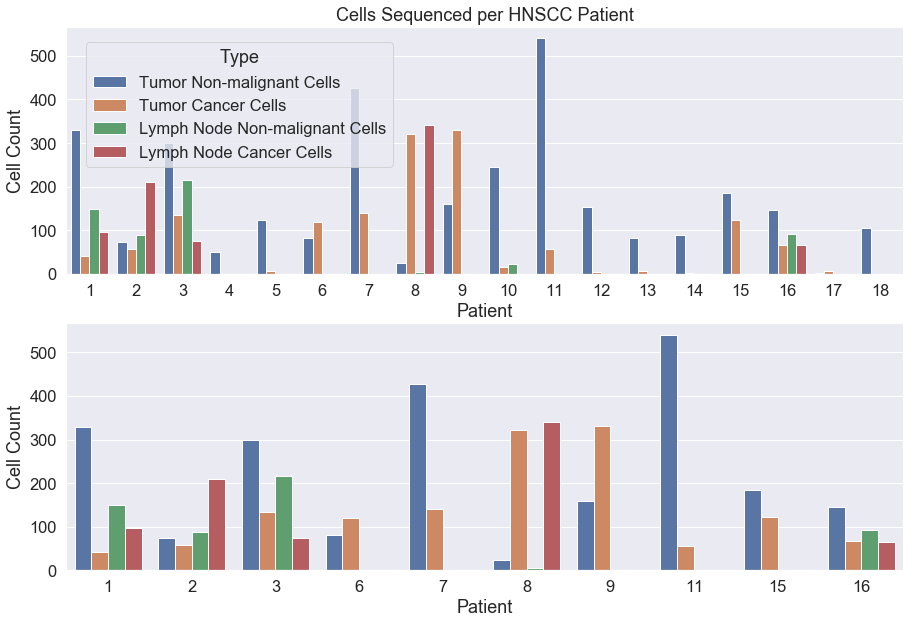

In [21]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)

plt.figure()
plt.subplot(211)
sns.barplot(x="Patient",y="value",hue="variable",data=melted_type_df)
plt.ylabel("Cell Count")
plt.legend(title="Type",loc="best",bbox_to_anchor=(.2,.4,.2,.2))
plt.title("Cells Sequenced per HNSCC Patient")
#plt.savefig(os.getcwd() + "/figures/scRNAseq_cellcount_bars/all18patients.png")
"""
plt.figure()
sns.barplot(x="Patient",y="value",hue="variable",data=melted_loc_df)
plt.ylabel("Cell Count")
plt.legend(title="Location",loc="best",bbox_to_anchor=(.8,.8,.2,.2))
plt.title("Cells Sequenced per HNSCC Patient")
plt.savefig(os.getcwd() + "/figures/scRNAseq_cellcount_bars/all18patients.png")

plt.figure()
sns.barplot(x="Patient",y="value",hue="variable",data=melted_tumor_df)
plt.ylabel("Cell Count")
plt.legend(title="Intratumoral Type",loc="best",bbox_to_anchor=(.8,.8,.2,.2))
plt.title("Cells Sequenced per HNSCC Patient")
plt.savefig(os.getcwd() + "/figures/scRNAseq_cellcount_bars/all18patients.png")
"""
plt.subplot(212)
g = sns.barplot(x="Patient",y="value",hue="variable",data=melted10_ccdf)
plt.ylabel("Cell Count")
#plt.legend(title="Type",loc="best",bbox_to_anchor=(.6,.8,.2,.2))
g.legend_.remove()
#plt.title("Cells Sequenced per HNSCC Patient")
plt.savefig(os.getcwd() + "/figures/scRNAseq_cellcount_bars/10patients.png")

In [65]:
gene_df = full_df.iloc[:,5:-1]
gene_df.sum(axis=1)
gene_df.head()
gene_df.T.to_csv(os.getcwd()+"\data\scRNAseq\scRNAseq_Xgene_Ysample_raw.csv")

In [12]:
tumor_redox_df = redox_df[redox_df["Lymph node"] == 0]

In [13]:
tumor_redox_df.shape

(3654, 40)

In [58]:
redox_df.to_csv(os.getcwd() + "\\data\\scRNAseq\\redoxdata.csv")

In [17]:
cancer_redoxdf = redox_df[redox_df["classified  as cancer cell"] == 1]
healthy_redoxdf = redox_df[redox_df["classified  as cancer cell"] == 0]

In [97]:
healthy_redoxdf[healthy_redoxdf["non-cancer index"] == 0]

,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer index,Tumor,ACTB,GAPDH,NFE2L2,KEAP1,ABCC3,...,GPX6,GPX7,GPX8,PRDX1,PRDX2,PRDX3,PRDX4,PRDX5,PRDX6,TXN
cell,,,,,,,,,,,,,,,,,,,,,
115,0,0,0,0,1,9.0425,8.42170,3.44600,1.8086,0.00000,...,0.0,0.0,0.000000,7.8103,3.5479,5.4578,3.9583,6.3262,5.3038,6.6090
212,0,0,0,0,3,9.2578,9.86880,4.63300,0.0000,0.37072,...,0.0,0.0,2.548400,7.4813,5.1103,3.6139,3.7650,5.8944,5.2233,4.8861
290,0,0,0,0,3,9.7585,9.88740,4.61950,3.4049,2.56560,...,0.0,0.0,0.038436,6.4588,4.7612,5.1536,0.0000,5.7632,4.8026,2.4518
371,0,0,0,0,1,6.8620,7.46940,4.76200,0.0000,4.82650,...,0.0,0.0,0.150560,7.6545,5.8915,0.0000,5.7923,4.0355,6.0307,5.7670
397,0,0,0,0,2,7.7337,9.43290,4.47240,4.7856,2.58110,...,0.0,0.0,0.000000,7.4164,5.6586,0.0000,6.5561,5.3949,0.0000,5.9504
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5808,0,0,0,0,8,10.1130,7.96700,4.96050,5.7290,0.00000,...,0.0,0.0,0.000000,1.2327,0.0000,5.8207,0.0000,6.8322,1.2600,5.0848
5822,0,0,0,0,9,6.5872,0.39944,7.69410,0.0000,0.00000,...,0.0,0.0,0.284510,0.0000,0.0000,0.0000,0.0000,6.4736,0.0000,5.8128
5863,0,0,0,0,9,8.6143,8.15530,0.33113,0.0000,0.00000,...,0.0,0.0,0.000000,6.3258,6.7615,5.4120,0.0000,6.5757,4.1294,6.9479


In [96]:
cancer_redoxdf[cancer_redoxdf["classified  as cancer cell"]==1]

,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer index,Tumor,ACTB,GAPDH,NFE2L2,KEAP1,ABCC3,...,GPX6,GPX7,GPX8,PRDX1,PRDX2,PRDX3,PRDX4,PRDX5,PRDX6,TXN
cell,,,,,,,,,,,,,,,,,,,,,
18,0,1,0,0,2,6.8271,10.9860,0.00000,5.9621,0.0000,...,0.0,0.0,0.000000,6.0629,4.8569,5.2254,6.4261,5.1170,5.93880,4.1967
20,0,1,0,0,2,8.7139,11.3020,3.43910,3.4003,0.0000,...,0.0,0.0,0.000000,6.7531,5.4497,5.5528,3.6281,6.3585,5.75940,3.6353
24,0,1,0,0,2,8.2097,6.8643,0.41143,0.0000,0.0000,...,0.0,0.0,0.000000,4.6913,0.0000,0.0000,5.2836,4.0266,0.27977,1.8444
31,0,1,0,0,3,9.4885,9.5403,4.04260,0.0000,0.0000,...,0.0,0.0,0.000000,7.7238,6.6430,4.8602,3.4791,6.5558,4.84290,5.9744
38,0,1,0,0,2,7.6279,9.7182,2.71300,3.8162,0.0000,...,0.0,0.0,0.000000,6.2932,4.0952,5.2503,5.0969,6.0146,6.29440,3.2956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5896,0,1,0,0,9,9.5064,8.1711,5.69840,0.0000,0.0000,...,0.0,0.0,0.000000,7.6853,7.0407,6.5447,5.5935,7.1425,4.62490,6.8370
5897,0,1,0,0,8,8.6282,9.1014,7.25390,5.2472,3.4171,...,0.0,0.0,0.237560,7.3734,4.1570,3.9470,4.1542,6.5160,3.72660,7.2635
5900,0,1,0,0,9,10.2490,8.9396,5.36190,2.9611,0.0000,...,0.0,0.0,0.042644,5.9442,6.4673,6.6932,5.3384,6.3620,4.72540,7.1802


In [ ]:
for gene in genes_of_interest:
    try:
        plt.figure()
        g = sns.violinplot(x="tumor",y=gene,hue="classified  as cancer cell",data=full_df[full_df["Lymph node"] == 0],cut=0)
        #plt.xticks(range(10),range(1,11))
        plt.xlabel("Patient")
        plt.ylabel("Transcripts per Million")
        plt.title(gene+" Gene Expression")
        plt.legend(bbox_to_anchor=(0.23,0.95,0,0))
        # title
        new_title = 'Cell Type'
        g.legend_.set_title(new_title)
        # replace labels
        new_labels = ['Non-Malignant', 'Cancer']
        for t, l in zip(g.legend_.texts, new_labels): t.set_text(l)
        #plt.savefig(os.getcwd()+"/figures/scRNAseq_violinplots/genes_per_patient/" + gene + "_cancersplit.png")
    except:
        continue


In [68]:
plt.close("all")

In [16]:
redox_df.shape

(4992, 40)

In [18]:

cancer_tsne = TSNE(n_components=2,n_jobs=-1,init='pca').fit_transform(cancer_redox_df)
#healthy_tsne = TSNE(n_components=2,n_jobs=-1,init='pca').fit_transform(healthy_redoxdf)

In [48]:
norm()

TypeError: __call__() missing 1 required positional argument: 'value'

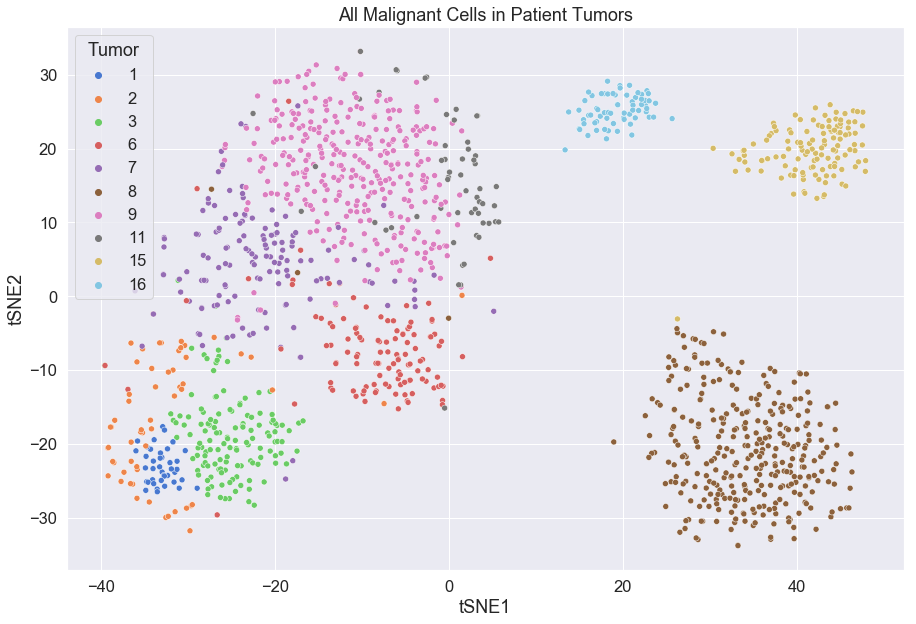

In [86]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
fig, ax = plt.subplots()
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],hue=redox_df["Tumor"],palette="muted",ax=ax)
ax.set(xlabel="tSNE1",
      ylabel="tSNE2",
      title="All Malignant Cells in Patient Tumors")
plt.savefig(os.getcwd()+"/figures/tSNE/cancer_redoxgenes_PCAinit_tumorcolor.png")
plt.show()

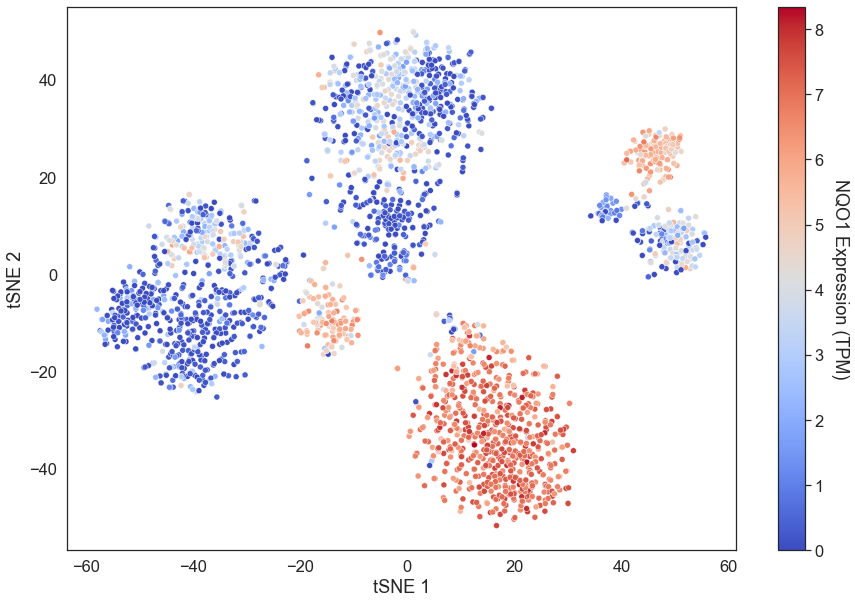

In [57]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
sns.set_style("white")
fig, ax = plt.subplots()

points = ax.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["NQO1"], s=15, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax)
cbar.ax.set_ylabel('NQO1 Expression (TPM)', rotation=270)
cbar.ax.yaxis.set_label_coords(2.6,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["NQO1"],cmap="coolwarm",ax=ax)
#ax.get_legend().remove()
ax.set(xlabel="tSNE 1",
      ylabel="tSNE 2")
plt.savefig(os.getcwd()+"/../figures/fig3b.png")
plt.show()


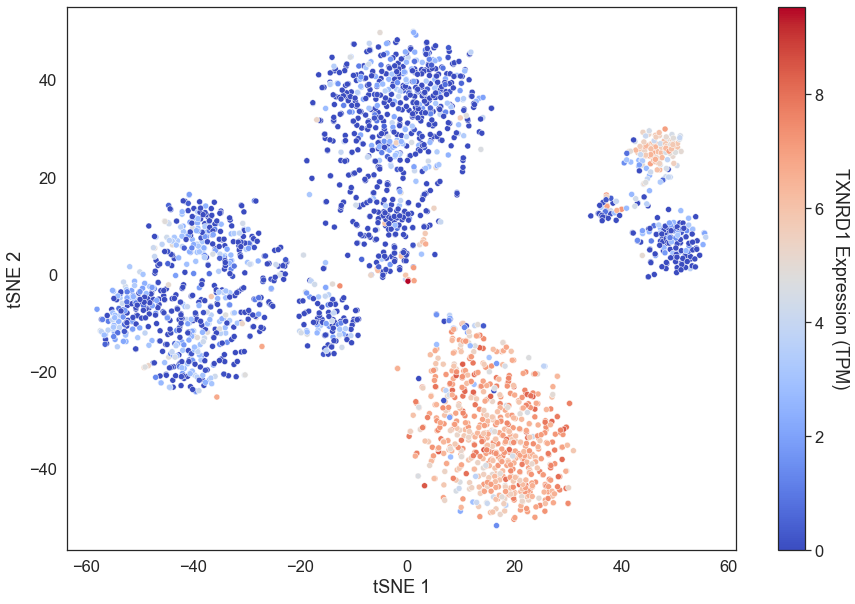

In [58]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
sns.set_style("white")
fig, ax = plt.subplots()

points = ax.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["TXNRD1"], s=15, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax)
cbar.ax.set_ylabel('TXNRD1 Expression (TPM)', rotation=270)
cbar.ax.yaxis.set_label_coords(2.6,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["TXNRD1"],cmap="coolwarm",ax=ax)
#ax.get_legend().remove()
ax.set(xlabel="tSNE 1",
      ylabel="tSNE 2")
plt.savefig(os.getcwd()+"/../figures/fig3c.png")
plt.show()

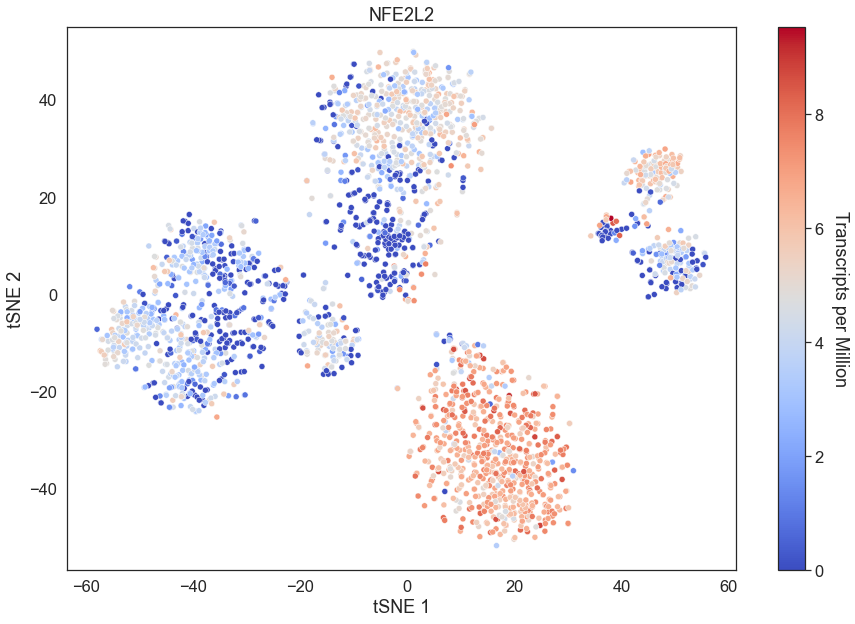

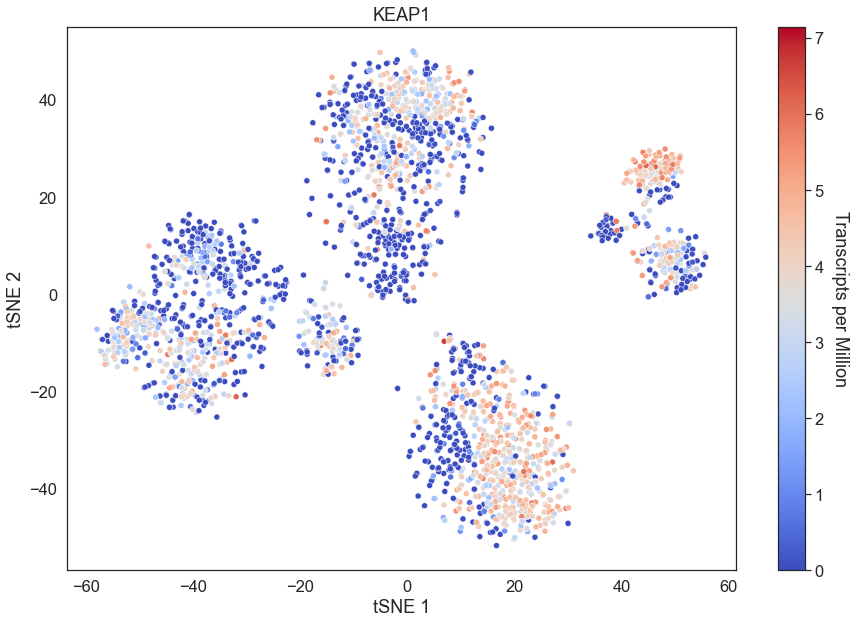

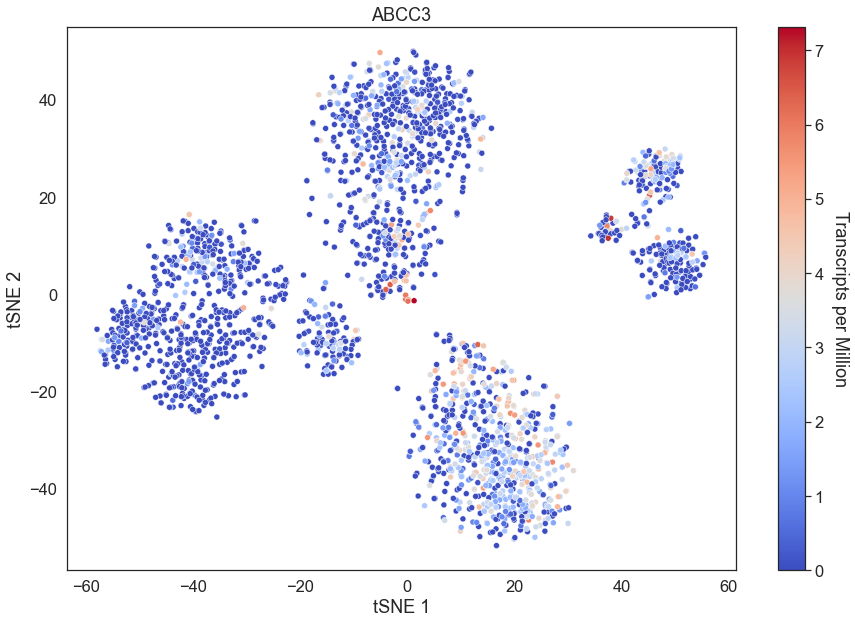

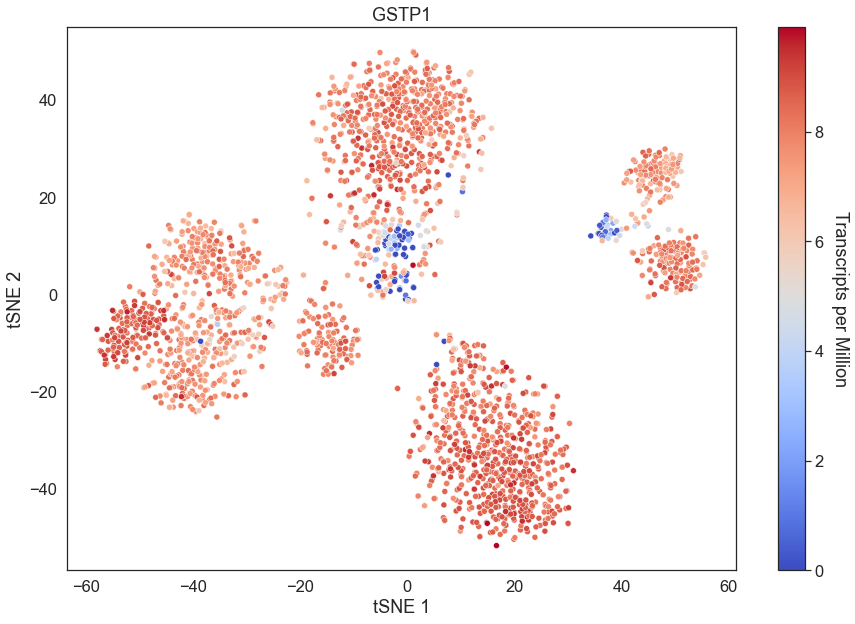

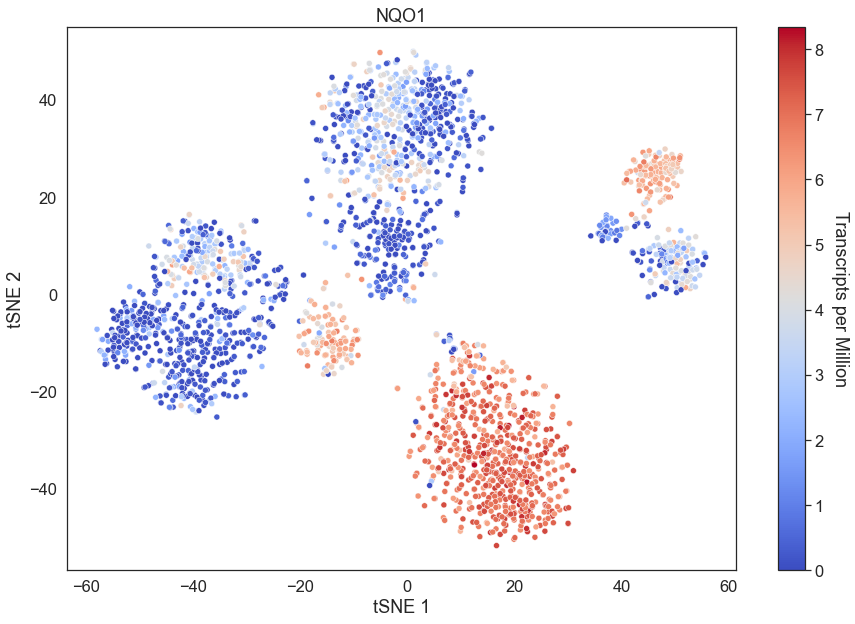

...

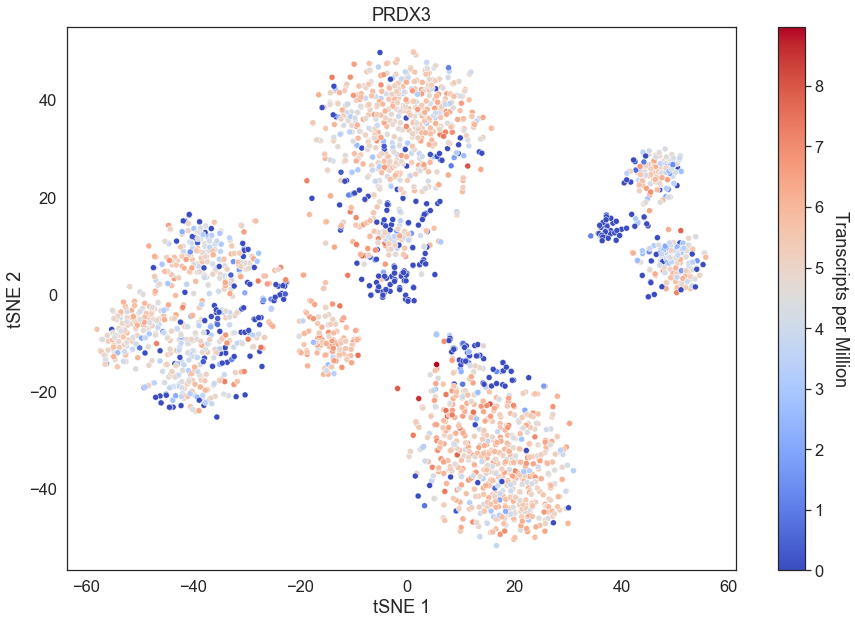

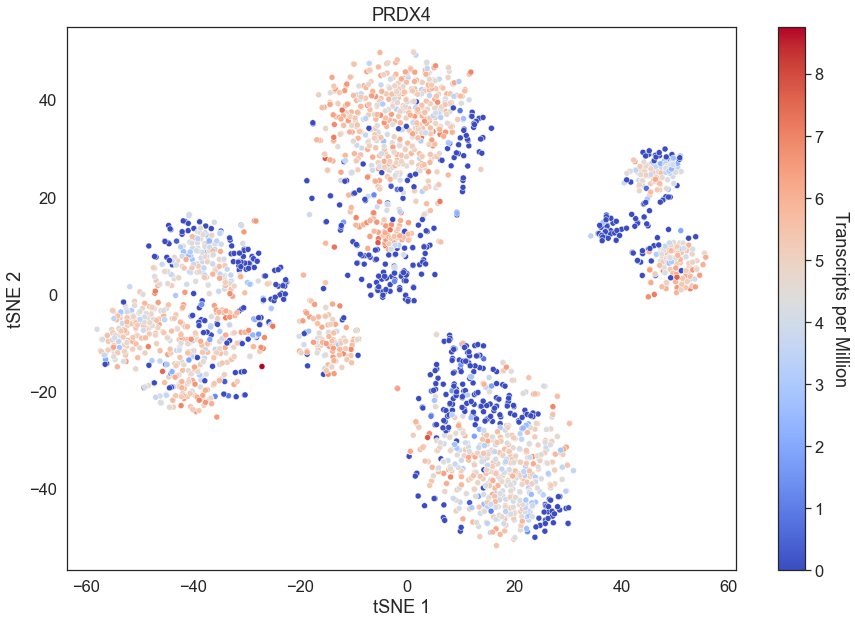

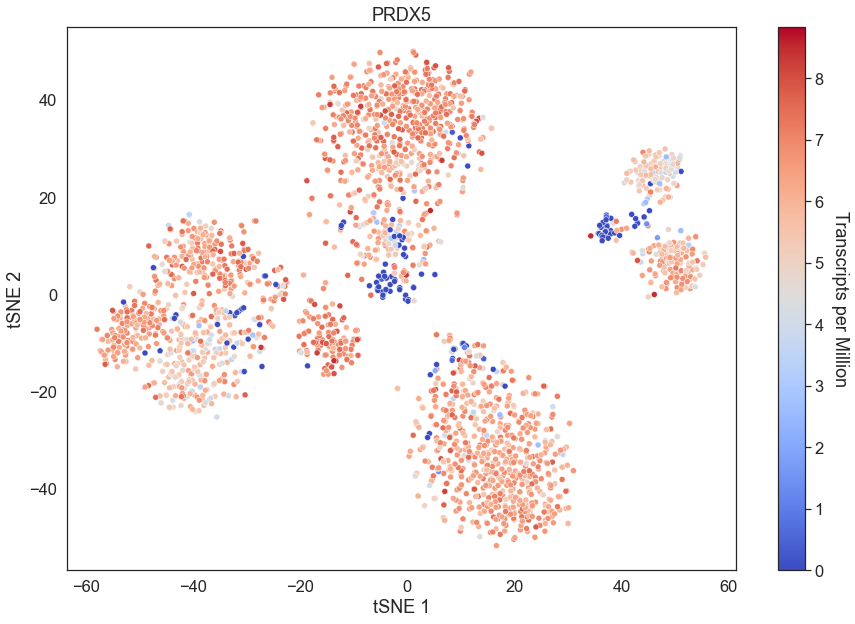

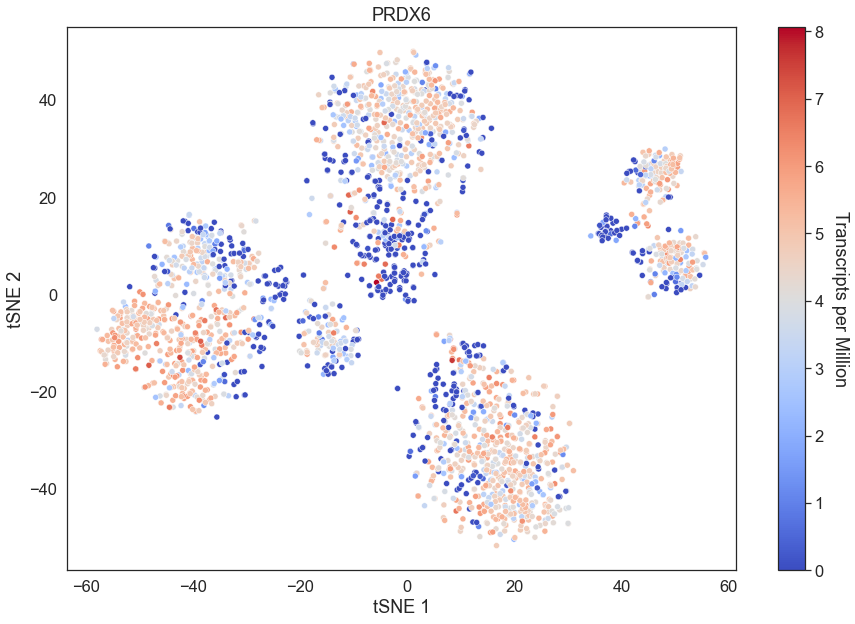

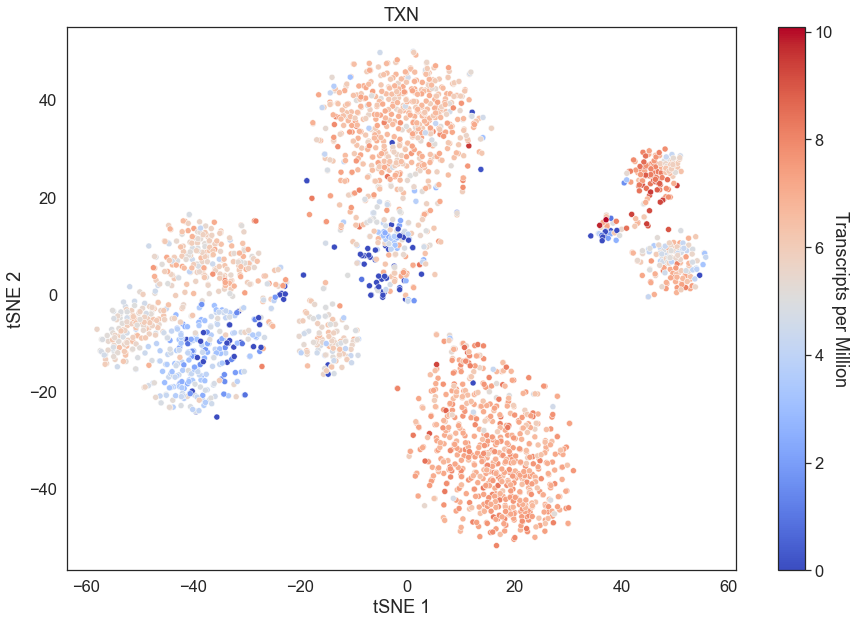

In [60]:
for gene in genes_of_interest:
    sns.set(rc={'figure.figsize':(15,10)})
    sns.set(font_scale=1.5)
    sns.set_style("white")
    fig, ax = plt.subplots()

    points = ax.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                         c=cancer_redox_df[gene], s=15, cmap="coolwarm")
    cbar = fig.colorbar(points,ax=ax)
    cbar.ax.set_ylabel('Transcripts per Million', rotation=270)
    cbar.ax.yaxis.set_label_coords(2.6,.5)
    sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df[gene],cmap="coolwarm",ax=ax)
    #ax.get_legend().remove()
    ax.set(xlabel="tSNE 1",
          ylabel="tSNE 2",
          title = gene)
    plt.savefig(os.getcwd()+"/../figures/"+ gene + "_TSNE.png")
    plt.show()

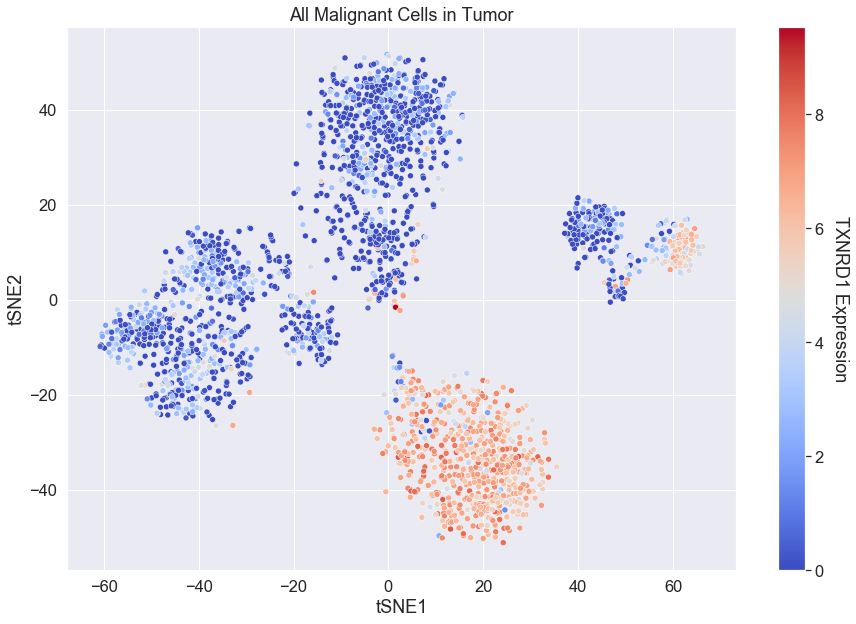

In [40]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
fig, ax = plt.subplots()

points = ax.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["TXNRD1"], s=15, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax)
cbar.ax.set_ylabel('TXNRD1 Expression', rotation=270)
cbar.ax.yaxis.set_label_coords(2.6,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["TXNRD1"],cmap="coolwarm",ax=ax)
#ax.get_legend().remove()
ax.set(xlabel="tSNE1",
      ylabel="tSNE2",
      title="All Malignant Cells in Tumor")
plt.savefig(os.getcwd()+"/20210823/cancer_redoxgenes_PCAinit_txnrd1color.png")
plt.show()

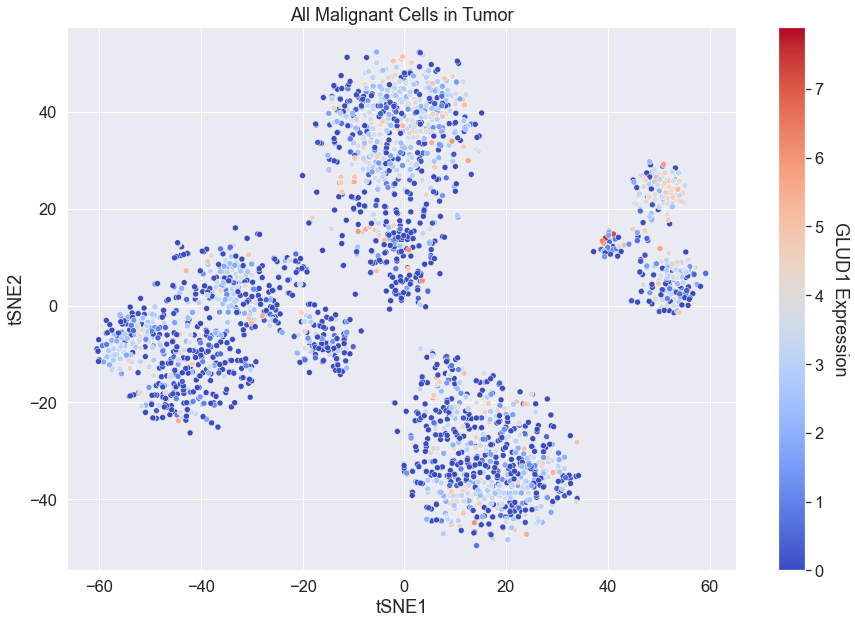

In [20]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
fig, ax = plt.subplots()

points = ax.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=cancer_redox_df["GLUD1"], s=15, cmap="coolwarm")
cbar = fig.colorbar(points,ax=ax)
cbar.ax.set_ylabel('GLUD1 Expression', rotation=270)
cbar.ax.yaxis.set_label_coords(2.6,.5)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=cancer_redox_df["GLUD1"],cmap="coolwarm",ax=ax)
#ax.get_legend().remove()
ax.set(xlabel="tSNE1",
      ylabel="tSNE2",
      title="All Malignant Cells in Tumor")
plt.savefig(os.getcwd()+"/cancer_redoxgenes_PCAinit_glud1color.png")
plt.show()

In [ ]:
fig, ax = plt.subplots()

points = ax.scatter(x=cancer_tsne[:,0],y=cancer_tsne[:,1],
                     c=redox_df["NQO1"], s=15, cmap="coolwarm")
plt.colorbar(points)
sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],c=redox_df["G6PD"],cmap="coolwarm",ax=ax)
#ax.get_legend().remove()
ax.set(xlabel="tSNE1",
      ylabel="tSNE2",
      title="All Malignant Cells in Tumor")
plt.savefig(os.getcwd()+"/figures/tSNE/cancer_redoxgenes_PCAinit_g6pdcolor.png")
plt.show()

In [70]:
cmap = sns.color_palette("coolwarm", as_cmap=True)

In [101]:
cancer_redoxdf.shape

(1388, 46)

In [ ]:
sns.set(rc={'figure.figsize':(15,10)})
sns.set(font_scale=1.5)
figs = genes_of_interest
for fig in figs:
    g = sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],hue=cancer_redoxdf[fig],palette=cmap)
    g.legend_.remove()
    plt.xlabel("tSNE1")
    #plt.xlim([-30, 30])
    #plt.ylim([-30, 40])
    plt.ylabel("tSNE2")
    plt.title("All Malignant Cells colored by " + fig)
    plt.savefig(os.getcwd()+"/figures/tSNE/" + fig + ".png")
    plt.show()

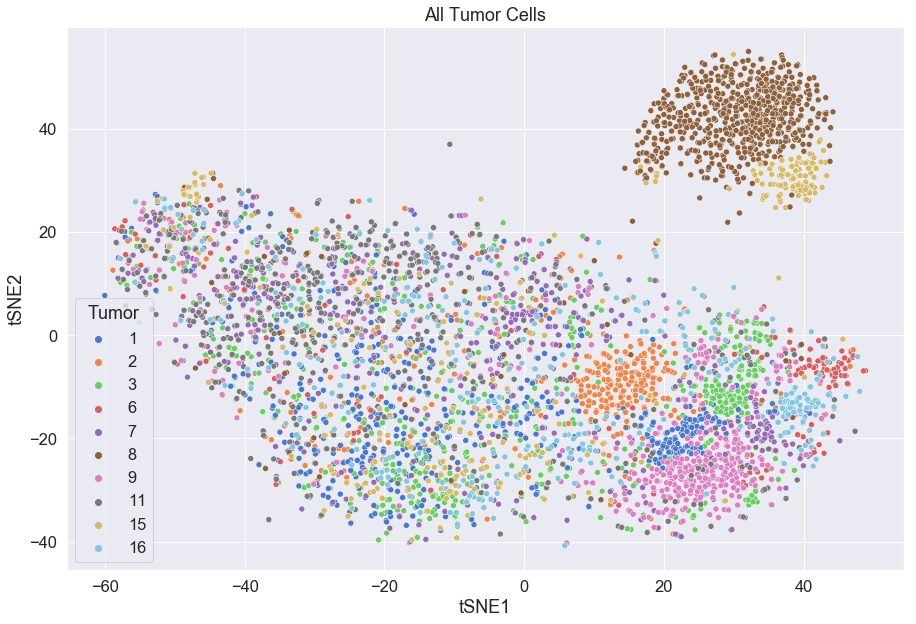

In [74]:
#all_tsne = TSNE(perplexity = 50,n_components=2,n_jobs=-1,init='pca').fit_transform(redox_df)
g = sns.scatterplot(x=all_tsne[:,0],y=all_tsne[:,1],hue=full_df["Tumor"],palette="muted")
plt.xlabel("tSNE1")
plt.ylabel("tSNE2")
plt.title("All Tumor Cells")
#plt.savefig(os.getcwd()+"/figures/tSNE/all_allgenes_PCAinit_tumorcolor.png")
plt.show()

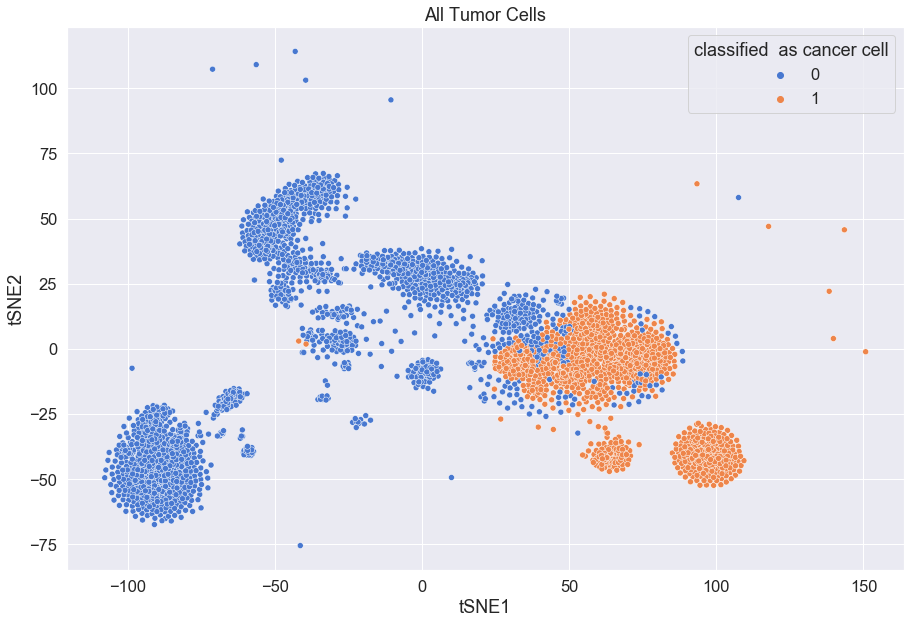

In [95]:
all_tsne = TSNE(perplexity = 50,n_components=2,n_jobs=-1,init='pca').fit_transform(full_df.iloc[:,6:])
g = sns.scatterplot(x=all_tsne[:,0],y=all_tsne[:,1],hue=full_df["classified  as cancer cell"],palette="muted")
plt.xlabel("tSNE1")
plt.ylabel("tSNE2")
plt.title("All Tumor Cells")
plt.savefig(os.getcwd()+"/figures/tSNE/all_allgenes_PCAinit_cancercolor.png")
plt.show()

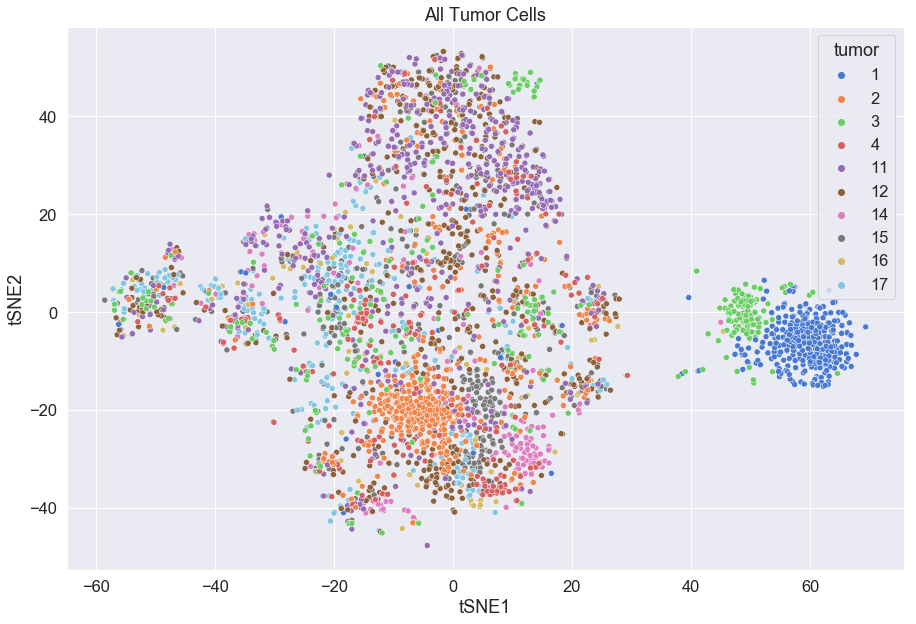

In [89]:
all_tsne = TSNE(perplexity = 50,n_components=2,n_jobs=-1).fit_transform(redox_df.iloc[:,5:])
g = sns.scatterplot(x=all_tsne[:,0],y=all_tsne[:,1],hue=redox_df["tumor"],palette="muted")
plt.xlabel("tSNE1")
plt.ylabel("tSNE2")
plt.title("All Tumor Cells")
plt.savefig(os.getcwd()+"/figures/tSNE/all.png")
plt.show()

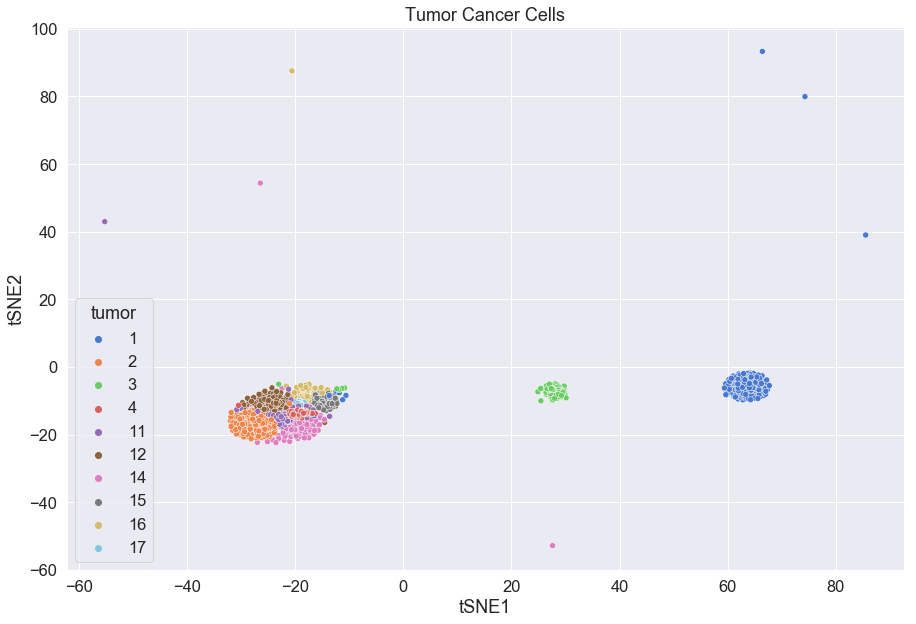

In [97]:
cancer_df = full_df[full_df["classified  as cancer cell"] == 1]
cancer_tsne = TSNE(perplexity = 50,n_components=2,n_jobs=-1,init='pca').fit_transform(cancer_df.iloc[:,6:])
g = sns.scatterplot(x=cancer_tsne[:,0],y=cancer_tsne[:,1],hue=cancer_df["tumor"],palette="muted")
plt.xlabel("tSNE1")
plt.ylabel("tSNE2")
plt.title("Tumor Cancer Cells")
plt.savefig(os.getcwd()+"/figures/tSNE/allgenes_cancer.png")
plt.show()

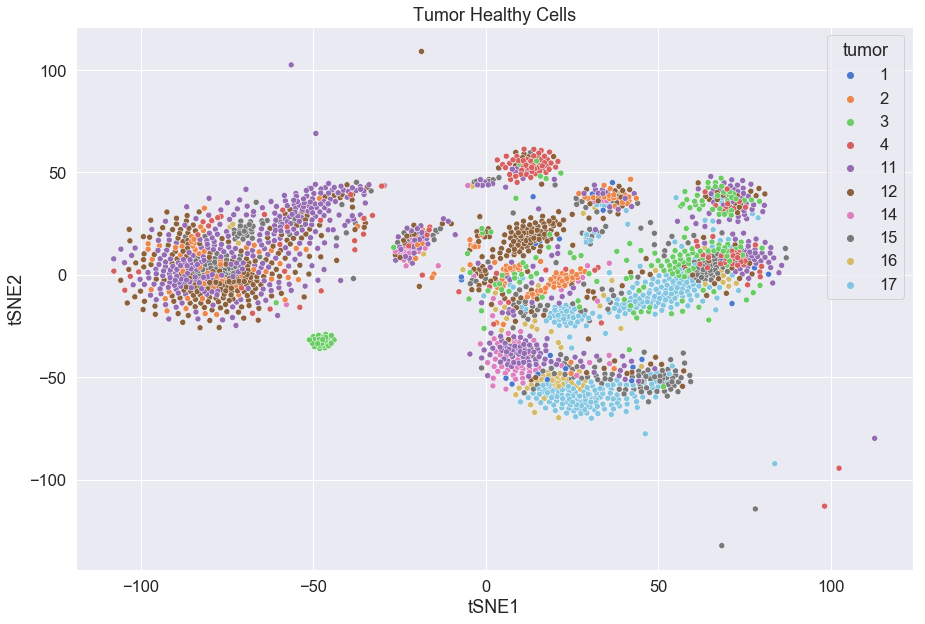

In [98]:
normal_df = full_df[full_df["classified  as cancer cell"] == 0]
normal_tsne = TSNE(perplexity = 50,n_components=2,n_jobs=-1,init='pca').fit_transform(normal_df.iloc[:,6:])
g = sns.scatterplot(x=normal_tsne[:,0],y=normal_tsne[:,1],hue=normal_df["tumor"],palette="muted")
plt.xlabel("tSNE1")
plt.ylabel("tSNE2")
plt.title("Tumor Healthy Cells")
plt.savefig(os.getcwd()+"/figures/tSNE/normal.png")
plt.show()

In [40]:
redox_df["tumor"].values

array([17, 17, 16, ...,  2,  1,  1])